<a href="https://colab.research.google.com/github/Natali-bali/TensorFlow_Tutorial/blob/master/04_transfer_learning_scale_up.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 06. Transfer Learning with TensorFlow Part 3: Scaling up (🍔👁 Food Vision mini)
Now we will use 101 images dataset from https://www.tensorflow.org/datasets/catalog/food101

We're going to go through the follow with TensorFlow:
- Downloading and preparing 10% of the Food101 data (10% of training data)
- Training a feature extraction transfer learning model on 10% of the Food101 training data
- Fine-tuning our feature extraction model
- Saving and loaded our trained model
- Evaluating the performance of our Food Vision model trained on 10% of the training data
- Finding our model's most wrong predictions
- Making predictions with our Food Vision model on custom images of food

### 1. Imports

In [1]:
!wget 'https://raw.githubusercontent.com/Natali-bali/TensorFlow_Tutorial/master/helper_functions.py'

--2021-06-25 11:46:47--  https://raw.githubusercontent.com/Natali-bali/TensorFlow_Tutorial/master/helper_functions.py
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 10447 (10K) [text/plain]
Saving to: ‘helper_functions.py’

helper_functions.py 100%[===================>]  10.20K  --.-KB/s    in 0s      

2021-06-25 11:46:47 (112 MB/s) - ‘helper_functions.py’ saved [10447/10447]



In [2]:
import pandas as pd
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt

from tensorflow.keras.preprocessing import image_dataset_from_directory
from tensorflow.keras import backend as K
from tensorflow.keras import Model
from tensorflow.keras.applications.efficientnet import EfficientNetB0
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D, Input
from tensorflow.keras.layers.experimental.preprocessing import RandomFlip, RandomHeight, RandomRotation, RandomZoom, RandomWidth
from helper_functions import plot_confusion_matrix, plot_loss_curves, classes_names, plot_pictures, create_tf_board_callback, unzip_file, compare_historys, walk_through_dir

### 2. Import and preprocess data

In [3]:
!wget https://storage.googleapis.com/ztm_tf_course/food_vision/101_food_classes_10_percent.zip 

--2021-06-25 11:46:50--  https://storage.googleapis.com/ztm_tf_course/food_vision/101_food_classes_10_percent.zip
Resolving storage.googleapis.com (storage.googleapis.com)... 172.253.63.128, 142.250.31.128, 142.250.65.80, ...
Connecting to storage.googleapis.com (storage.googleapis.com)|172.253.63.128|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1625420029 (1.5G) [application/zip]
Saving to: ‘101_food_classes_10_percent.zip’

101_food_classes_10 100%[===================>]   1.51G   157MB/s    in 9.5s    

2021-06-25 11:47:00 (164 MB/s) - ‘101_food_classes_10_percent.zip’ saved [1625420029/1625420029]



In [4]:
unzip_file('/content/101_food_classes_10_percent.zip')

In [5]:
walk_through_dir('/content/101_food_classes_10_percent')

There are 2 directories, 0 files in /content/101_food_classes_10_percent
There are 101 directories, 0 files in /content/101_food_classes_10_percent/train
There are 0 directories, 75 files in /content/101_food_classes_10_percent/train/baklava
There are 0 directories, 75 files in /content/101_food_classes_10_percent/train/lasagna
There are 0 directories, 75 files in /content/101_food_classes_10_percent/train/pancakes
There are 0 directories, 75 files in /content/101_food_classes_10_percent/train/guacamole
There are 0 directories, 75 files in /content/101_food_classes_10_percent/train/takoyaki
There are 0 directories, 75 files in /content/101_food_classes_10_percent/train/pork_chop
There are 0 directories, 75 files in /content/101_food_classes_10_percent/train/apple_pie
There are 0 directories, 75 files in /content/101_food_classes_10_percent/train/prime_rib
There are 0 directories, 75 files in /content/101_food_classes_10_percent/train/sashimi
There are 0 directories, 75 files in /conten

In [6]:
train_data_dir = '/content/101_food_classes_10_percent/train'
test_data_dir = '/content/101_food_classes_10_percent/test'

### 3. Check classes and explore our data

In [7]:
labels = classes_names(train_data_dir)

['apple_pie' 'baby_back_ribs' 'baklava' 'beef_carpaccio' 'beef_tartare'
 'beet_salad' 'beignets' 'bibimbap' 'bread_pudding' 'breakfast_burrito'
 'bruschetta' 'caesar_salad' 'cannoli' 'caprese_salad' 'carrot_cake'
 'ceviche' 'cheese_plate' 'cheesecake' 'chicken_curry'
 'chicken_quesadilla' 'chicken_wings' 'chocolate_cake' 'chocolate_mousse'
 'churros' 'clam_chowder' 'club_sandwich' 'crab_cakes' 'creme_brulee'
 'croque_madame' 'cup_cakes' 'deviled_eggs' 'donuts' 'dumplings' 'edamame'
 'eggs_benedict' 'escargots' 'falafel' 'filet_mignon' 'fish_and_chips'
 'foie_gras' 'french_fries' 'french_onion_soup' 'french_toast'
 'fried_calamari' 'fried_rice' 'frozen_yogurt' 'garlic_bread' 'gnocchi'
 'greek_salad' 'grilled_cheese_sandwich' 'grilled_salmon' 'guacamole'
 'gyoza' 'hamburger' 'hot_and_sour_soup' 'hot_dog' 'huevos_rancheros'
 'hummus' 'ice_cream' 'lasagna' 'lobster_bisque' 'lobster_roll_sandwich'
 'macaroni_and_cheese' 'macarons' 'miso_soup' 'mussels' 'nachos'
 'omelette' 'onion_rings' 'oy

In [8]:
len(labels)

101

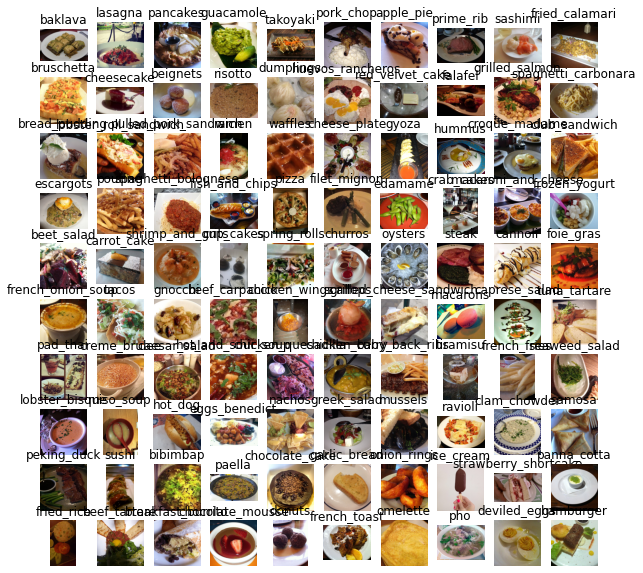

In [9]:
plot_pictures(train_data_dir, 10)

### Prepare Train and Test data

In [10]:
IMG_SIZE = (224,224)
BATCH_SIZE = 32

In [11]:
train_data = image_dataset_from_directory(train_data_dir, label_mode='categorical', batch_size=BATCH_SIZE, image_size=IMG_SIZE)
test_data = image_dataset_from_directory(test_data_dir, label_mode='categorical', batch_size=BATCH_SIZE, image_size=IMG_SIZE, shuffle=False)
#we dont shuffle data to check in future what labels have bad predictions

Found 7575 files belonging to 101 classes.
Found 25250 files belonging to 101 classes.


In [12]:
train_data

<BatchDataset shapes: ((None, 224, 224, 3), (None, 101)), types: (tf.float32, tf.float32)>

We're going to start by using feature extraction transfer learning with a pre-trained model for a few epochs and then fine-tune for a few more epochs.

-  ModelCheckpoint callback to save our progress during training, this means we could experiment with further training later without having to train from scratch every time
- Data augmentation built right into the model
- A headless (no top layers) EfficientNetB0 architecture from tf.keras.applications as our base model
- A Dense layer with 101 hidden neurons (same as number of food classes) and softmax activation as the output layer
Categorical crossentropy 
- The Adam optimizer with the default settings
- Fitting for 5 full passes on the training data while evaluating on 15% of the test data


In [13]:
base_model = EfficientNetB0(include_top=False)
base_model.trainable = False

16711680/16705208 [==============================] - 0s 0us/step


In [14]:
augment_layer = tf.keras.Sequential([RandomFlip("horizontal"),
                                     RandomHeight(0.2),
                                     RandomRotation(4),
                                     RandomWidth(0.2),
                                     RandomZoom(0.2)])
gap_layer = GlobalAveragePooling2D()
inputs = Input(shape = (224,224,3))
outputs = Dense(101, activation='softmax')

In [15]:
#Build our modedel
x = augment_layer(inputs)
x = base_model(x)
x = gap_layer(x)
outputs = outputs(x)

### Create checkpoint callback function

In [16]:
#We save weights only
def create_checkpoint(model_num):
  """Returns checkpoint callback function, args: model number"""
  checkpoint_filepath = 'checkpoints/checkpoint_'+str(model_num)+'.ckpt'
  model_checkpoints = tf.keras.callbacks.ModelCheckpoint(checkpoint_filepath, monitor='val_loss', verbose=1, save_best_only=True,
                                                          save_weights_only=True, save_freq='epoch',
                                                          options=None)
  return model_checkpoints

In [17]:
model_1 = Model(inputs, outputs)

In [18]:
model_1.compile(optimizer = 'adam', loss = 'categorical_crossentropy', metrics = ['accuracy'])

In [19]:
history_1 = model_1.fit(train_data, epochs = 5, callbacks=create_checkpoint(1),
            validation_data = test_data, steps_per_epoch = len(train_data), validation_steps = int(0.15*len(test_data)))

Epoch 1/5
237/237 [==============================] - 122s 365ms/step - loss: 3.5920 - accuracy: 0.2172 - val_loss: 2.7526 - val_accuracy: 0.3822

Epoch 00001: val_loss improved from inf to 2.75257, saving model to checkpoints/checkpoint_1.ckpt
Epoch 2/5
237/237 [==============================] - 71s 300ms/step - loss: 2.5472 - accuracy: 0.4173 - val_loss: 2.2900 - val_accuracy: 0.4576

Epoch 00002: val_loss improved from 2.75257 to 2.29004, saving model to checkpoints/checkpoint_1.ckpt
Epoch 3/5
237/237 [==============================] - 64s 269ms/step - loss: 2.2230 - accuracy: 0.4644 - val_loss: 2.1161 - val_accuracy: 0.4868

Epoch 00003: val_loss improved from 2.29004 to 2.11612, saving model to checkpoints/checkpoint_1.ckpt
Epoch 4/5
237/237 [==============================] - 62s 260ms/step - loss: 2.0182 - accuracy: 0.5072 - val_loss: 1.9731 - val_accuracy: 0.5053

Epoch 00004: val_loss improved from 2.11612 to 1.97307, saving model to checkpoints/checkpoint_1.ckpt
Epoch 5/5
237/2

### Create db to save our results

In [20]:
result_df = pd.DataFrame(columns = ['model', 'test_acc'])

In [21]:
def save_res(model, model_name, test_data = test_data):
  global result_df
  result = model.evaluate(test_data)
  result_df.loc[len(result_df)] = [model_name, result]

In [22]:
save_res(model_1, 'model_1')

790/790 [==============================] - 87s 110ms/step - loss: 1.8034 - accuracy: 0.5331


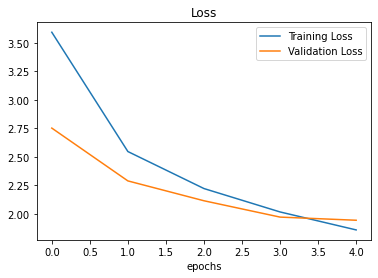

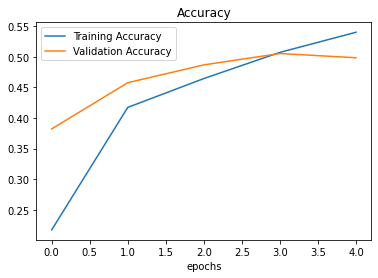

In [23]:
plot_loss_curves(history_1)

### Fine tuning

In [24]:
#This rime we will freez only 5 layers
base_model.trainable = True
for layer in base_model.layers[:-5]:
  layer.trainable = False

In [25]:
#!Dont forget to decrease learning rate!
model_1.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.0001), metrics = ['accuracy'], loss = 'categorical_crossentropy')

In [26]:
history_2 = model_1.fit(train_data, epochs = 10, initial_epoch=5, steps_per_epoch=len(train_data),
            validation_data = test_data, validation_steps = int(0.15*len(test_data)),
            callbacks = create_checkpoint(2))

Epoch 6/10
237/237 [==============================] - 65s 245ms/step - loss: 1.7872 - accuracy: 0.5628 - val_loss: 1.9005 - val_accuracy: 0.5135

Epoch 00006: val_loss improved from inf to 1.90048, saving model to checkpoints/checkpoint_2.ckpt
Epoch 7/10
237/237 [==============================] - 57s 239ms/step - loss: 1.6396 - accuracy: 0.5989 - val_loss: 1.8334 - val_accuracy: 0.5260

Epoch 00007: val_loss improved from 1.90048 to 1.83341, saving model to checkpoints/checkpoint_2.ckpt
Epoch 8/10
237/237 [==============================] - 52s 218ms/step - loss: 1.5462 - accuracy: 0.6128 - val_loss: 1.7828 - val_accuracy: 0.5363

Epoch 00008: val_loss improved from 1.83341 to 1.78281, saving model to checkpoints/checkpoint_2.ckpt
Epoch 9/10
237/237 [==============================] - 51s 213ms/step - loss: 1.4868 - accuracy: 0.6240 - val_loss: 1.7530 - val_accuracy: 0.5442

Epoch 00009: val_loss improved from 1.78281 to 1.75302, saving model to checkpoints/checkpoint_2.ckpt
Epoch 10/10


In [27]:
save_res(model_1, 'model_1_fine_5_layers')

790/790 [==============================] - 87s 110ms/step - loss: 1.6227 - accuracy: 0.5682


5
10
[0.21716171503067017, 0.4172937273979187, 0.46442243456840515, 0.5071946978569031, 0.5400660037994385, 0.562772274017334, 0.5989438891410828, 0.6128053069114685, 0.6240264177322388, 0.6386798620223999]


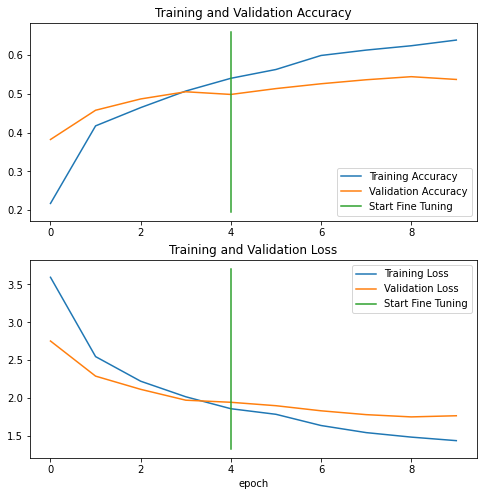

In [28]:
compare_historys(history_1, history_2)

In [29]:
model_1.save('/content/drive/MyDrive/projects/SPICED/models/model_1')

/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/utils/generic_utils.py:497: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  category=CustomMaskWarning)


INFO:tensorflow:Assets written to: /content/drive/MyDrive/projects/SPICED/models/model_1/assets


### Load model from GoogleDrive

In [30]:
model = tf.keras.models.load_model('/content/drive/MyDrive/projects/SPICED/models')

In [31]:
save_res(model, 'model_3_from_saved')

790/790 [==============================] - 89s 111ms/step - loss: 1.6207 - accuracy: 0.5689


In [32]:
result_df

,model,test_acc
0,model_1,"[1.8033779859542847, 0.5330693125724792]"
1,model_1_fine_5_layers,"[1.6226938962936401, 0.5682376027107239]"
2,model_3_from_saved,"[1.6207093000411987, 0.568871259689331]"


### Confusion Matrix

In [33]:
pred_probs = model.predict(test_data)

In [34]:
preds = np.array(tf.argmax(pred_probs, axis = 1))

In [35]:
preds.shape

(25250,)

### Get labels from BatchDataset

In [36]:
y_test = []
for images, labels in test_data.unbatch():
  y_test.append(labels.numpy().argmax())

In [37]:
y_test[:10]

[0, 0, 0, 0, 0, 0, 0, 0, 0, 0]

In [38]:
labels = classes_names(train_data_dir)

['apple_pie' 'baby_back_ribs' 'baklava' 'beef_carpaccio' 'beef_tartare'
 'beet_salad' 'beignets' 'bibimbap' 'bread_pudding' 'breakfast_burrito'
 'bruschetta' 'caesar_salad' 'cannoli' 'caprese_salad' 'carrot_cake'
 'ceviche' 'cheese_plate' 'cheesecake' 'chicken_curry'
 'chicken_quesadilla' 'chicken_wings' 'chocolate_cake' 'chocolate_mousse'
 'churros' 'clam_chowder' 'club_sandwich' 'crab_cakes' 'creme_brulee'
 'croque_madame' 'cup_cakes' 'deviled_eggs' 'donuts' 'dumplings' 'edamame'
 'eggs_benedict' 'escargots' 'falafel' 'filet_mignon' 'fish_and_chips'
 'foie_gras' 'french_fries' 'french_onion_soup' 'french_toast'
 'fried_calamari' 'fried_rice' 'frozen_yogurt' 'garlic_bread' 'gnocchi'
 'greek_salad' 'grilled_cheese_sandwich' 'grilled_salmon' 'guacamole'
 'gyoza' 'hamburger' 'hot_and_sour_soup' 'hot_dog' 'huevos_rancheros'
 'hummus' 'ice_cream' 'lasagna' 'lobster_bisque' 'lobster_roll_sandwich'
 'macaroni_and_cheese' 'macarons' 'miso_soup' 'mussels' 'nachos'
 'omelette' 'onion_rings' 'oy

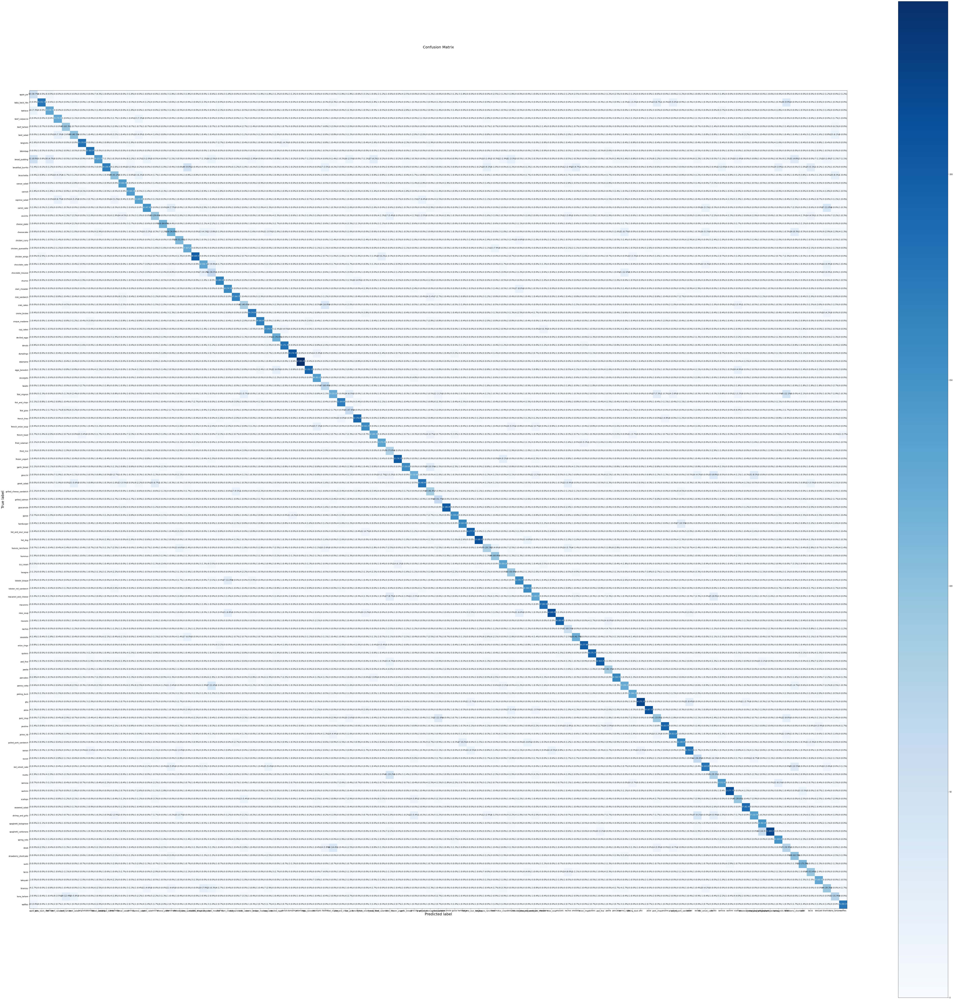

In [39]:
#plot_confusion_matrix
plot_confusion_matrix(y_test, preds, figsize = (100,100), classes = list(labels))

### Classification report

In [40]:
from sklearn.metrics import classification_report

In [41]:
print(classification_report(y_test, preds))

              precision    recall  f1-score   support

           0       0.31      0.20      0.24       250
           1       0.51      0.70      0.59       250
           2       0.59      0.51      0.55       250
           3       0.70      0.50      0.59       250
           4       0.63      0.37      0.47       250
           5       0.40      0.40      0.40       250
           6       0.71      0.73      0.72       250
           7       0.82      0.73      0.77       250
           8       0.22      0.56      0.31       250
           9       0.34      0.68      0.46       250
          10       0.41      0.40      0.40       250
          11       0.67      0.57      0.62       250
          12       0.64      0.56      0.60       250
          13       0.50      0.53      0.51       250
          14       0.48      0.60      0.53       250
          15       0.30      0.37      0.33       250
          16       0.64      0.46      0.54       250
          17       0.37    

In [42]:
class_report = classification_report(y_test, preds, output_dict=True)

In [43]:
class_report

{'0': {'f1-score': 0.24213075060532693,
  'precision': 0.3067484662576687,
  'recall': 0.2,
  'support': 250},
 '1': {'f1-score': 0.5945945945945945,
  'precision': 0.5146198830409356,
  'recall': 0.704,
  'support': 250},
 '10': {'f1-score': 0.40408163265306124,
  'precision': 0.4125,
  'recall': 0.396,
  'support': 250},
 '100': {'f1-score': 0.641025641025641,
  'precision': 0.5912162162162162,
  'recall': 0.7,
  'support': 250},
 '11': {'f1-score': 0.6163793103448276,
  'precision': 0.6682242990654206,
  'recall': 0.572,
  'support': 250},
 '12': {'f1-score': 0.5982905982905983,
  'precision': 0.6422018348623854,
  'recall': 0.56,
  'support': 250},
 '13': {'f1-score': 0.5145067698259187,
  'precision': 0.49812734082397003,
  'recall': 0.532,
  'support': 250},
 '14': {'f1-score': 0.532859680284192,
  'precision': 0.4792332268370607,
  'recall': 0.6,
  'support': 250},
 '15': {'f1-score': 0.3297872340425532,
  'precision': 0.2961783439490446,
  'recall': 0.372,
  'support': 250},
 '

In [44]:
report = {}
for key, item in class_report.items():
  if key == 'accuracy':
    break
  report[key] = [labels[int(key)], round(item['f1-score'],2)]

In [45]:
report_df = pd.DataFrame.from_dict(report, orient='index', columns = ['name', 'f1-score'])

In [46]:
report_df

,name,f1-score
0,apple_pie,0.24
1,baby_back_ribs,0.59
2,baklava,0.55
3,beef_carpaccio,0.59
4,beef_tartare,0.47
...,...,...
96,tacos,0.44
97,takoyaki,0.57
98,tiramisu,0.38
99,tuna_tartare,0.30


In [47]:
report_df = report_df.sort_values('f1-score', ascending = True)

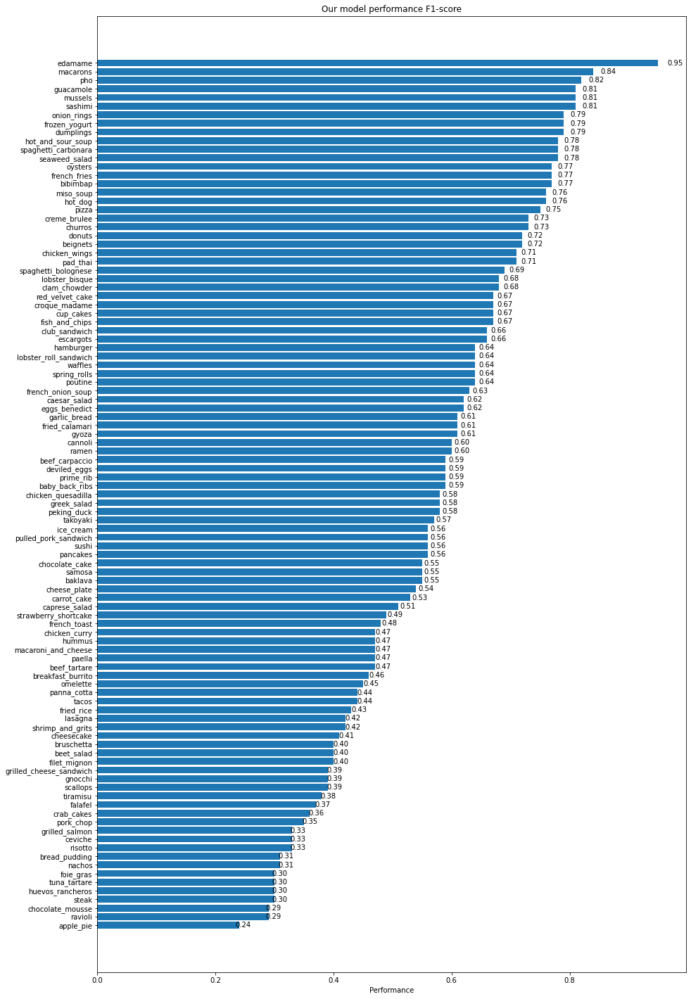

In [48]:
fig, ax = plt.subplots(figsize=(15, 25))

scores = ax.barh(np.arange(len(report_df)), report_df['f1-score'], align='center')
ax.set_yticks(np.arange(len(report_df)))
ax.set_yticklabels(report_df['name'])
# ax.invert_yaxis()  # labels read top-to-bottom
ax.set_xlabel('Performance')
ax.set_title('Our model performance F1-score')

def autolabel(rects):
    """
    Attach a text label above each bar displaying its height
    """
    for rect in rects:
      width = rect.get_width()
      ax.text(1.03*width, rect.get_y(), f"{width:.2f}", ha='center', va='bottom')

autolabel(scores)

plt.show()

### Plot random images from each class with predictions

In [49]:
def load_and_prep_image(filename, img_shape=224, scale=True):
  """
  Reads in an image from filename, turns it into a tensor and reshapes into
  (224, 224, 3).

  Parameters
  ----------
  filename (str): string filename of target image
  img_shape (int): size to resize target image to, default 224
  scale (bool): whether to scale pixel values to range(0, 1), default True
  """
  # Read in the image
  img = tf.io.read_file(filename)
  # Decode it into a tensor
  img = tf.io.decode_image(img)
  # Resize the image
  img = tf.image.resize(img, [img_shape, img_shape])
  img = tf.expand_dims(img, axis = 0)
  if scale:
    # Rescale the image (get all values between 0 and 1)
    return img/255.
  else:
    return img

In [50]:
import os
import random

In [51]:
labels

array(['apple_pie', 'baby_back_ribs', 'baklava', 'beef_carpaccio',
       'beef_tartare', 'beet_salad', 'beignets', 'bibimbap',
       'bread_pudding', 'breakfast_burrito', 'bruschetta', 'caesar_salad',
       'cannoli', 'caprese_salad', 'carrot_cake', 'ceviche',
       'cheese_plate', 'cheesecake', 'chicken_curry',
       'chicken_quesadilla', 'chicken_wings', 'chocolate_cake',
       'chocolate_mousse', 'churros', 'clam_chowder', 'club_sandwich',
       'crab_cakes', 'creme_brulee', 'croque_madame', 'cup_cakes',
       'deviled_eggs', 'donuts', 'dumplings', 'edamame', 'eggs_benedict',
       'escargots', 'falafel', 'filet_mignon', 'fish_and_chips',
       'foie_gras', 'french_fries', 'french_onion_soup', 'french_toast',
       'fried_calamari', 'fried_rice', 'frozen_yogurt', 'garlic_bread',
       'gnocchi', 'greek_salad', 'grilled_cheese_sandwich',
       'grilled_salmon', 'guacamole', 'gyoza', 'hamburger',
       'hot_and_sour_soup', 'hot_dog', 'huevos_rancheros', 'hummus',
       

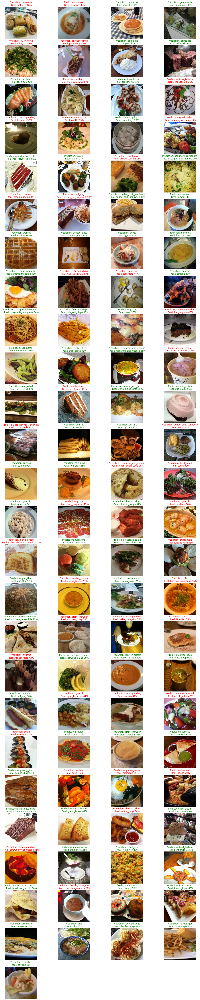

In [52]:

fig, ax = plt.subplots(figsize=(20,100))
directories = os.listdir(test_data_dir)
num_img = len(directories)+4
for dir, num in zip(directories, range(num_img)):
    plt.subplot(num_img/4, num_img/25, num+1)
    file_name = random.choice(os.listdir(test_data_dir + '/' + dir))
    file_path = test_data_dir + '/' + dir + '/' + file_name
    image = load_and_prep_image(file_path, scale = False)
    pred_prob = model.predict(image)
    pred = np.argmax(pred_prob, axis = 1)
    # print(f'Prediction: {labels[pred[0]] }')
    # print(f'Real: {dir}')   
    if labels[pred[0]] == dir:
      color = 'green'
    else:
      color = 'red'
    plt.title(f'Prediction: {labels[pred[0]]} \n Real: {dir} {tf.reduce_max(pred_prob)*100:2.0f}%', color = color)
    plt.axis('off')
  
    plt.imshow(image[0]/255., cmap = plt.cm.binary)

### Finding the most wrong predictions
It's a good idea to go through at least 100+ random instances of your model's predictions to get a good feel for how it's doing.
After a while you might notice the model predicting on some images with a very high prediction probability, meaning it's very confident with its prediction but still getting the label wrong.
These most wrong predictions can help to give further insight into your model's performance.

So how about we write some code to collect all of the predictions where the model has output a high prediction probability for an image (e.g. 0.95+) but gotten the prediction wrong.

We'll go through the following steps:
- Get all of the image file paths in the test dataset using the list_files() method.
- Create a pandas DataFrame of the image filepaths, ground truth labels, prediction classes, max prediction probabilities, ground truth class names and predicted class names.
- Use our DataFrame to find all the wrong predictions (where the ground truth doesn't match the prediction).
- Sort the DataFrame based on wrong predictions and highest max prediction probabilities.
- Visualize the images with the highest prediction probabilities but have the wrong prediction.

In [53]:
filepaths = []
for filepath in test_data.list_files("101_food_classes_10_percent/test/*/*.jpg", shuffle=False):
  filepaths.append(filepath.numpy())
filepaths[:10]

[b'101_food_classes_10_percent/test/apple_pie/1011328.jpg',
 b'101_food_classes_10_percent/test/apple_pie/101251.jpg',
 b'101_food_classes_10_percent/test/apple_pie/1034399.jpg',
 b'101_food_classes_10_percent/test/apple_pie/103801.jpg',
 b'101_food_classes_10_percent/test/apple_pie/1038694.jpg',
 b'101_food_classes_10_percent/test/apple_pie/1047447.jpg',
 b'101_food_classes_10_percent/test/apple_pie/1068632.jpg',
 b'101_food_classes_10_percent/test/apple_pie/110043.jpg',
 b'101_food_classes_10_percent/test/apple_pie/1106961.jpg',
 b'101_food_classes_10_percent/test/apple_pie/1113017.jpg']

In [74]:
df = pd.DataFrame({'file_path': filepaths,
                   'y_true': y_test,
                   'y_pred': preds,
                   "pred_conf": pred_probs.max(axis=1), # get the maximum prediction probability value
                   "y_true_classname": [labels[i] for i in y_test],
                   "y_pred_classname": [labels[i] for i in preds]}) 


In [79]:
df['correct'] = df['y_true_classname'] == df['y_pred_classname']

In [80]:
df

,file_path,y_true,y_pred,pred_conf,y_true_classname,y_pred_classname,correct
0,b'101_food_classes_10_percent/test/apple_pie/1...,0,0,0.460691,apple_pie,apple_pie,True
1,b'101_food_classes_10_percent/test/apple_pie/1...,0,0,0.948017,apple_pie,apple_pie,True
2,b'101_food_classes_10_percent/test/apple_pie/1...,0,0,0.299962,apple_pie,apple_pie,True
3,b'101_food_classes_10_percent/test/apple_pie/1...,0,38,0.221947,apple_pie,fish_and_chips,False
4,b'101_food_classes_10_percent/test/apple_pie/1...,0,8,0.378654,apple_pie,bread_pudding,False
...,...,...,...,...,...,...,...
25245,b'101_food_classes_10_percent/test/waffles/942...,100,100,0.971357,waffles,waffles,True
25246,b'101_food_classes_10_percent/test/waffles/954...,100,100,0.664195,waffles,waffles,True
25247,b'101_food_classes_10_percent/test/waffles/961...,100,56,0.252388,waffles,huevos_rancheros,False
25248,b'101_food_classes_10_percent/test/waffles/970...,100,100,0.305393,waffles,waffles,True


In [77]:
df.describe()

,y_true,y_pred,pred_conf
count,25250.000000,25250.000000,25250.000000
mean,50.000000,49.722297,0.555248
std,29.155337,29.319645,0.275844
min,0.000000,0.000000,0.060595
25%,25.000000,24.000000,0.311913
50%,50.000000,50.000000,0.510250
75%,75.000000,76.000000,0.819399
max,100.000000,100.000000,0.999996


In [96]:
df_worse_pred = df.loc[df.correct == False].sort_values('pred_conf', ascending = False)[:100]

In [97]:
df_worse_pred

,file_path,y_true,y_pred,pred_conf,y_true_classname,y_pred_classname,correct
23631,b'101_food_classes_10_percent/test/strawberry_...,94,83,0.997506,strawberry_shortcake,red_velvet_cake,False
23797,b'101_food_classes_10_percent/test/sushi/16593...,95,86,0.996841,sushi,sashimi,False
10847,b'101_food_classes_10_percent/test/fried_calam...,43,68,0.995950,fried_calamari,onion_rings,False
11097,b'101_food_classes_10_percent/test/fried_rice/...,44,70,0.989116,fried_rice,pad_thai,False
21216,b'101_food_classes_10_percent/test/risotto/493...,84,70,0.988916,risotto,pad_thai,False
...,...,...,...,...,...,...,...
9202,b'101_food_classes_10_percent/test/falafel/390...,36,20,0.924002,falafel,chicken_wings,False
11041,b'101_food_classes_10_percent/test/fried_rice/...,44,51,0.923609,fried_rice,guacamole,False
22729,b'101_food_classes_10_percent/test/spaghetti_b...,90,91,0.921741,spaghetti_bolognese,spaghetti_carbonara,False
3914,b'101_food_classes_10_percent/test/ceviche/357...,15,85,0.921397,ceviche,samosa,False


In [98]:
df_worse_pred = df_worse_pred.reset_index().drop('index', axis = 1)

### Plot worse predictions

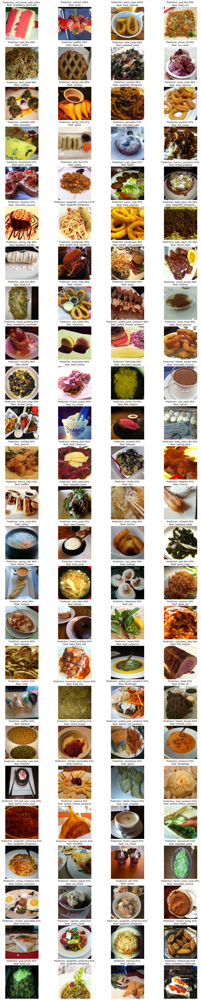

In [103]:
fig, ax = plt.subplots(figsize = (20,100))
num_img  = 100
for index, row in df_worse_pred.iterrows():
  path = row.file_path
  img = load_and_prep_image(path, scale = False)
  plt.subplot(num_img/4, num_img/25, index + 1)
  plt.title(f'Prediction: {row.y_pred_classname} {row.pred_conf*100:2.0f}% \n Real: {row.y_true_classname} ')
  plt.axis('off')
  plt.imshow(img[0]/255., cmap = plt.cm.binary)

### Make predictions on custom pictures

In [104]:
!wget 'https://storage.googleapis.com/ztm_tf_course/food_vision/custom_food_images.zip'

--2021-06-25 12:48:09--  https://storage.googleapis.com/ztm_tf_course/food_vision/custom_food_images.zip
Resolving storage.googleapis.com (storage.googleapis.com)... 142.251.33.208, 172.217.9.208, 172.217.164.176, ...
Connecting to storage.googleapis.com (storage.googleapis.com)|142.251.33.208|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 13192985 (13M) [application/zip]
Saving to: ‘custom_food_images.zip’

custom_food_images. 100%[===================>]  12.58M  63.3MB/s    in 0.2s    

2021-06-25 12:48:09 (63.3 MB/s) - ‘custom_food_images.zip’ saved [13192985/13192985]



In [105]:
unzip_file('/content/custom_food_images.zip')

In [106]:
images_list = [img for img in os.listdir('/content/custom_food_images')]

In [107]:
images_list

['chicken_wings.jpeg',
 'hamburger.jpeg',
 'ramen.jpeg',
 'steak.jpeg',
 'pizza-dad.jpeg',
 'sushi.jpeg']

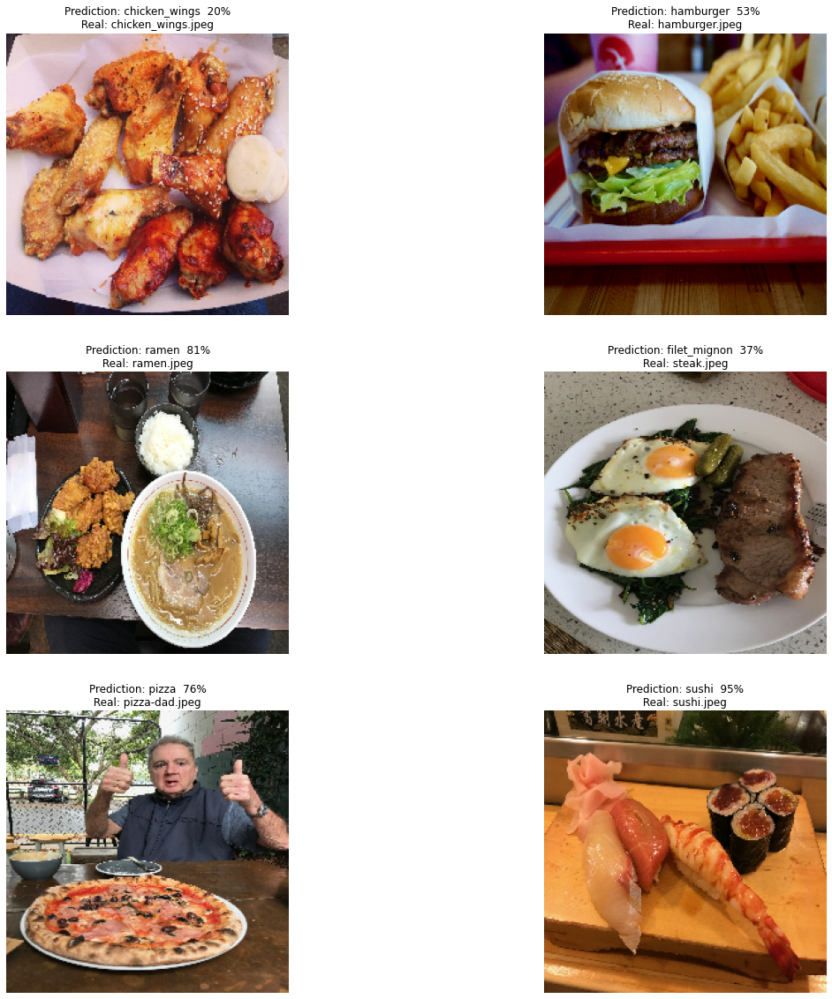

In [113]:
fig, ax = plt.subplots(figsize = (20,20))
num_img  = len(images_list)
for ind, item in enumerate(images_list):
  path = '/content/custom_food_images'+'/'+item
  img = load_and_prep_image(path, scale = False)
  pred_prob = model.predict(img)
  pred = np.array(tf.argmax(pred_prob, axis = 1))

  plt.subplot(num_img/2, num_img/3, ind + 1)
  plt.title(f'Prediction: {labels[pred][0]}  {tf.argmax(pred_prob, axis = 1)[0]}%\n Real: {item} ')
  plt.axis('off')
  plt.imshow(img[0]/255., cmap = plt.cm.binary)